<a href="https://colab.research.google.com/github/Duyuyuy/Airbnb_Analysis_Project/blob/main/Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# **Project - Los Angeles Airbnb data analysis**

Trần Bảo Duy - ITDSIU20061


In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
!pip install fuzzywuzzy
!pip install pandas_profiling==3.2.0
!pip install folium
!pip install markupsafe==2.0.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 262.6/262.6 KB 18.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.4/102.4 KB 15.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.8/679.8 KB 60.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 309.8/309.8 KB 38.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 114.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 KB 40.6 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=ee601cc24daa678eb0cf7881e90a683d867e85a145fe2a8569d8cc5a0827f8c0
  Stored in directory: /root/.cache/pip/wheels/1d/05/04/c6d7d3b66539d9e659ac6dfe81e2d0fd4c1a8316cc5a403300
Successfully bui

In [3]:
import os
import re
import random
import numpy as np
import pandas as pd
import folium as fo
import seaborn as sns
import pandas_profiling
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import matplotlib.patches as mpatches
import statsmodels.formula.api as smf
%matplotlib inline

from scipy.stats import linregress
from sklearn.metrics import r2_score
from folium.plugins import BeautifyIcon
from statsmodels.formula.api import logit
from fuzzywuzzy import process
from fuzzywuzzy import fuzz

/usr/local/lib/python3.9/dist-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [4]:
os.chdir('/content/gdrive/My Drive/data')

## **I. Data Introduction**

**Raw data collected from [Airbnb](http://insideairbnb.com/get-the-data/):**

In [5]:
raw_data = pd.read_csv('listings.csv')

### **I.1. Data Size**

The data include 75 columns, listed below:

In [6]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40438 entries, 0 to 40437
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            40438 non-null  int64  
 1   listing_url                                   40438 non-null  object 
 2   scrape_id                                     40438 non-null  int64  
 3   last_scraped                                  40438 non-null  object 
 4   source                                        40438 non-null  object 
 5   name                                          40436 non-null  object 
 6   description                                   39701 non-null  object 
 7   neighborhood_overview                         23505 non-null  object 
 8   picture_url                                   40438 non-null  object 
 9   host_id                                       40438 non-null 

Along with the length of 45815 rows

In [7]:
print('This data contains {} rows'.format(len(raw_data)))

This data contains 40438 rows


### **I.2. Data Columns**

In total of 75 columns, there are 25 columns with worthy insights. Therefore, this project drops out all other 50 columns.

In [8]:
data = raw_data.drop(columns = ['listing_url', 'scrape_id', 'last_scraped', 'source', 'reviews_per_month', 'number_of_reviews_l30d', 'number_of_reviews_ltm',
                                'calendar_last_scraped', 'availability_90', 'availability_30', 'availability_60', 'has_availability', 'calendar_updated',
                                'minimum_minimum_nights', 'maximum_minimum_nights', 'minimum_maximum_nights', 'maximum_maximum_nights', 'maximum_nights_avg_ntm',
                                'minimum_nights_avg_ntm', 'host_is_superhost', 'host_about', 'host_location', 'host_name', 'host_since', 'host_url', 'picture_url',
                                'host_response_time', 'host_response_rate', 'host_acceptance_rate', 'host_thumbnail_url', 'host_picture_url', 'host_verifications',
                                'license', 'calculated_host_listings_count_shared_rooms', 'calculated_host_listings_count_private_rooms',
                                'calculated_host_listings_count_entire_homes', 'calculated_host_listings_count','host_listings_count', 'host_has_profile_pic',
                                'host_neighbourhood', 'first_review', 'last_review', 'bathrooms', 'neighbourhood_group_cleansed', 'neighbourhood', 'bathrooms',
                                'neighborhood_overview', 'name', 'description', 'host_total_listings_count', 'beds'])

The remained data contains 25 columns and 45815 rows.

*Columns:*

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40438 entries, 0 to 40437
Data columns (total 25 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           40438 non-null  int64  
 1   host_id                      40438 non-null  int64  
 2   host_identity_verified       40436 non-null  object 
 3   neighbourhood_cleansed       40438 non-null  object 
 4   latitude                     40438 non-null  float64
 5   longitude                    40438 non-null  float64
 6   property_type                40438 non-null  object 
 7   room_type                    40438 non-null  object 
 8   accommodates                 40438 non-null  int64  
 9   bathrooms_text               40398 non-null  object 
 10  bedrooms                     36835 non-null  float64
 11  amenities                    40438 non-null  object 
 12  price                        40438 non-null  object 
 13  minimum_nights  

*Rows:*

In [10]:
print('This data contains {} rows'.format(len(data)))

This data contains 40438 rows


## **II. Data Preprocessing**

### **II.1. Remove null value**

There are 10 columns that contain null values in this data, including:

In [11]:
for c in data.columns:
  if data[c].isnull().values.any():
    print(c)

host_identity_verified
bathrooms_text
bedrooms
review_scores_rating
review_scores_accuracy
review_scores_cleanliness
review_scores_checkin
review_scores_communication
review_scores_location
review_scores_value


This section divides null-contain columns into 3 categories and handles them in 3 different ways.

*Columns with large number of nulls:*

In [12]:
# Create a view table with columns having large number of nulls:
#replace 0 rating by 1 (min rating=1)

table = data[['host_id', 'review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication',
              'review_scores_location', 'review_scores_value']]
table.replace(to_replace = 0, value = 1, inplace = True)
table = table.groupby('host_id').agg(np.nanmean).reset_index()
table

/usr/local/lib/python3.9/dist-packages/pandas/core/frame.py:5238: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().replace(


,host_id,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,521,4.000,5.000,5.0,3.00,4.000,5.00,4.0
1,767,4.200,4.200,4.0,4.40,4.200,4.60,4.2
2,2410,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2851,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3008,4.825,4.835,4.9,4.94,4.925,4.85,4.8
...,...,...,...,...,...,...,...,...
20687,489988329,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20688,490091405,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20689,490121002,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20690,490208171,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
# Remove all rows with no data:

table = table[~table.isna().any(axis=1)]
table

,host_id,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,521,4.000000,5.000000,5.000000,3.000000,4.00000,5.000000,4.000000
1,767,4.200000,4.200000,4.000000,4.400000,4.20000,4.600000,4.200000
4,3008,4.825000,4.835000,4.900000,4.940000,4.92500,4.850000,4.800000
5,3041,4.510000,4.455000,4.540000,4.635000,4.72500,4.940000,4.375000
6,3144,4.970000,4.960000,4.950000,5.000000,5.00000,4.970000,4.850000
...,...,...,...,...,...,...,...,...
20660,488812561,5.000000,5.000000,5.000000,5.000000,5.00000,3.000000,5.000000
20665,488888227,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000
20674,489156831,5.000000,5.000000,5.000000,5.000000,5.00000,4.000000,5.000000
20677,489315589,4.910000,4.895000,4.935000,4.955000,4.97125,4.816250,4.853750


In [14]:
# Merge the table with the data by removing old columns and add columns in the table to the data:

data = data.drop(columns=['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication',
                          'review_scores_location', 'review_scores_value'])
data = data.merge(table, on = 'host_id')
data

,id,host_id,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,...,availability_365,number_of_reviews,instant_bookable,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,65467,61864,t,Culver City,34.024380,-118.383740,Private room in home,Private room,2,2 baths,...,365,0,f,4.810,4.690,4.780,4.94,4.94,4.940,4.44
1,4120719,61864,t,Venice,33.998310,-118.473260,Private room in townhouse,Private room,1,1 shared bath,...,364,36,f,4.810,4.690,4.780,4.94,4.94,4.940,4.44
2,206662,33861,t,Hollywood Hills West,34.104200,-118.347480,Private room in condo,Private room,1,1 shared bath,...,84,95,f,4.820,4.800,4.760,4.89,4.92,4.920,4.87
3,67089,210344,t,Culver City,34.009850,-118.407980,Entire guesthouse,Entire home/apt,3,1 bath,...,254,698,f,4.895,4.915,4.855,4.95,4.92,4.915,4.86
4,46858,210344,t,Culver City,34.012690,-118.407880,Entire home,Entire home/apt,6,2 baths,...,118,171,f,4.895,4.915,4.855,4.95,4.92,4.915,4.86
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34870,769223112243380115,486478436,t,West Covina,34.015596,-117.897599,Entire home,Entire home/apt,8,3 baths,...,356,1,f,5.000,5.000,5.000,5.00,5.00,5.000,5.00
34871,770486246791020516,469115498,t,Sawtelle,34.028520,-118.439410,Entire home,Entire home/apt,6,2 baths,...,317,1,f,5.000,5.000,5.000,5.00,5.00,5.000,5.00
34872,771016672892582873,71184942,t,Marina del Rey,33.984089,-118.456956,Entire rental unit,Entire home/apt,6,2 baths,...,168,1,f,5.000,5.000,5.000,5.00,5.00,5.000,5.00
34873,770647370744591002,489156831,t,Temple City,34.110288,-118.056351,Entire home,Entire home/apt,3,1 bath,...,354,1,f,5.000,5.000,5.000,5.00,5.00,4.000,5.00


*bedrooms column:*

In [15]:
value = {"bedrooms" : 1} 
data.fillna(value = value, inplace = True)

*Other columns:*

In [16]:
# Remove nulls in bathroom_text column:

data = data[~data['bathrooms_text'].isna()]

In [17]:
# Remove nulls in host_identity_verified column:

data = data[~data['host_identity_verified'].isna()]

Data after removing all null values:

In [18]:
data

,id,host_id,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,...,availability_365,number_of_reviews,instant_bookable,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,65467,61864,t,Culver City,34.024380,-118.383740,Private room in home,Private room,2,2 baths,...,365,0,f,4.810,4.690,4.780,4.94,4.94,4.940,4.44
1,4120719,61864,t,Venice,33.998310,-118.473260,Private room in townhouse,Private room,1,1 shared bath,...,364,36,f,4.810,4.690,4.780,4.94,4.94,4.940,4.44
2,206662,33861,t,Hollywood Hills West,34.104200,-118.347480,Private room in condo,Private room,1,1 shared bath,...,84,95,f,4.820,4.800,4.760,4.89,4.92,4.920,4.87
3,67089,210344,t,Culver City,34.009850,-118.407980,Entire guesthouse,Entire home/apt,3,1 bath,...,254,698,f,4.895,4.915,4.855,4.95,4.92,4.915,4.86
4,46858,210344,t,Culver City,34.012690,-118.407880,Entire home,Entire home/apt,6,2 baths,...,118,171,f,4.895,4.915,4.855,4.95,4.92,4.915,4.86
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34870,769223112243380115,486478436,t,West Covina,34.015596,-117.897599,Entire home,Entire home/apt,8,3 baths,...,356,1,f,5.000,5.000,5.000,5.00,5.00,5.000,5.00
34871,770486246791020516,469115498,t,Sawtelle,34.028520,-118.439410,Entire home,Entire home/apt,6,2 baths,...,317,1,f,5.000,5.000,5.000,5.00,5.00,5.000,5.00
34872,771016672892582873,71184942,t,Marina del Rey,33.984089,-118.456956,Entire rental unit,Entire home/apt,6,2 baths,...,168,1,f,5.000,5.000,5.000,5.00,5.00,5.000,5.00
34873,770647370744591002,489156831,t,Temple City,34.110288,-118.056351,Entire home,Entire home/apt,3,1 bath,...,354,1,f,5.000,5.000,5.000,5.00,5.00,4.000,5.00


### **II.2. Modify column**

Modify *bathrooms_text* column:

In [19]:

# Converting function:

def convert(n):
  if "half-bath" in str(n):
    return 1
  if re.findall('[\d]*[.]?[\d]*', str(n))[0] != '':
    return int(np.ceil(float(re.findall('[\d]*[.]?[\d]*', str(n))[0])))

In [20]:
# Add new columns and drop old column:

data['num_of_bath'] = [convert(n) for n in list(data['bathrooms_text'])]
data['bath_type'] = ['share' if 'share' in str(n) else 'private' for n in list(data['bathrooms_text'])]
data = data[~data['num_of_bath'].isnull()]
data.drop('bathrooms_text', axis = 1, inplace = True)

data[['num_of_bath', 'bath_type']]

/usr/local/lib/python3.9/dist-packages/pandas/core/frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


,num_of_bath,bath_type
0,2.0,private
1,1.0,share
2,1.0,share
3,1.0,private
4,2.0,private
...,...,...
34870,3.0,private
34871,2.0,private
34872,2.0,private
34873,1.0,private


Modify *property_type* column:

In [21]:
cat = ['home', 'condo', 'guesthouse', 'rental unit', 'suite', 'villa', 'townhouse' , 'bungalow', 'apartment', 'loft', 'hotel', 'cottage',
       'bed and breakfast', 'resort', 'hostel', 'camper/rv']  
dic = {}
count = 0

for state in cat:  
    matches = process.extract(state, data['property_type'], limit = data.shape[0])
    for potential_match in matches:
        if potential_match[1] >= 80:    


            data.loc[data['property_type'] == potential_match[0], 'property_type'] = state

d = data.loc[data['property_type'].isin(cat) == False , 'property_type'] = 'others'

data['property_type'].unique()

/usr/local/lib/python3.9/dist-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


array(['home', 'townhouse', 'condo', 'guesthouse', 'rental unit',
       'bungalow', 'suite', 'villa', 'loft', 'hostel', 'cottage',
       'camper/rv', 'apartment', 'others', 'bed and breakfast', 'resort'],
      dtype=object)

Modify *price* column:

In [22]:
data['price'] = data['price'].str.replace('\W', '').astype('int64') / 100
data['price']

<ipython-input-22-068bccf6343a>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  data['price'] = data['price'].str.replace('\W', '').astype('int64') / 100
<ipython-input-22-068bccf6343a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['price'] = data['price'].str.replace('\W', '').astype('int64') / 100


0        300.0
1        151.0
2         46.0
3        140.0
4        300.0
         ...  
34870    229.0
34871    342.0
34872    257.0
34873     92.0
34874    201.0
Name: price, Length: 34826, dtype: float64

Create *satisfied* column:

In [23]:
data['satisfied'] = data.loc[:,['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value']].sum(axis = 1)
data.loc[data['satisfied'] < 32.5, 'satisfied'] = 0
data.loc[data['satisfied'] >= 32.5, 'satisfied'] = 1

<ipython-input-23-4c4ae3442f2f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['satisfied'] = data.loc[:,['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',


Data after modifying columns:

In [24]:
data

,id,host_id,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,...,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,num_of_bath,bath_type,satisfied
0,65467,61864,t,Culver City,34.024380,-118.383740,home,Private room,2,1.0,...,4.810,4.690,4.780,4.94,4.94,4.940,4.44,2.0,private,1.0
1,4120719,61864,t,Venice,33.998310,-118.473260,townhouse,Private room,1,1.0,...,4.810,4.690,4.780,4.94,4.94,4.940,4.44,1.0,share,1.0
2,206662,33861,t,Hollywood Hills West,34.104200,-118.347480,condo,Private room,1,1.0,...,4.820,4.800,4.760,4.89,4.92,4.920,4.87,1.0,share,1.0
3,67089,210344,t,Culver City,34.009850,-118.407980,guesthouse,Entire home/apt,3,1.0,...,4.895,4.915,4.855,4.95,4.92,4.915,4.86,1.0,private,1.0
4,46858,210344,t,Culver City,34.012690,-118.407880,home,Entire home/apt,6,3.0,...,4.895,4.915,4.855,4.95,4.92,4.915,4.86,2.0,private,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34870,769223112243380115,486478436,t,West Covina,34.015596,-117.897599,home,Entire home/apt,8,4.0,...,5.000,5.000,5.000,5.00,5.00,5.000,5.00,3.0,private,1.0
34871,770486246791020516,469115498,t,Sawtelle,34.028520,-118.439410,home,Entire home/apt,6,3.0,...,5.000,5.000,5.000,5.00,5.00,5.000,5.00,2.0,private,1.0
34872,771016672892582873,71184942,t,Marina del Rey,33.984089,-118.456956,rental unit,Entire home/apt,6,2.0,...,5.000,5.000,5.000,5.00,5.00,5.000,5.00,2.0,private,1.0
34873,770647370744591002,489156831,t,Temple City,34.110288,-118.056351,home,Entire home/apt,3,1.0,...,5.000,5.000,5.000,5.00,5.00,4.000,5.00,1.0,private,1.0


### **II.3. Removing extreme value** 

In [25]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 34826 entries, 0 to 34874
Data columns (total 27 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           34826 non-null  int64  
 1   host_id                      34826 non-null  int64  
 2   host_identity_verified       34826 non-null  object 
 3   neighbourhood_cleansed       34826 non-null  object 
 4   latitude                     34826 non-null  float64
 5   longitude                    34826 non-null  float64
 6   property_type                34826 non-null  object 
 7   room_type                    34826 non-null  object 
 8   accommodates                 34826 non-null  int64  
 9   bedrooms                     34826 non-null  float64
 10  amenities                    34826 non-null  object 
 11  price                        34826 non-null  float64
 12  minimum_nights               34826 non-null  int64  
 13  maximum_nights  

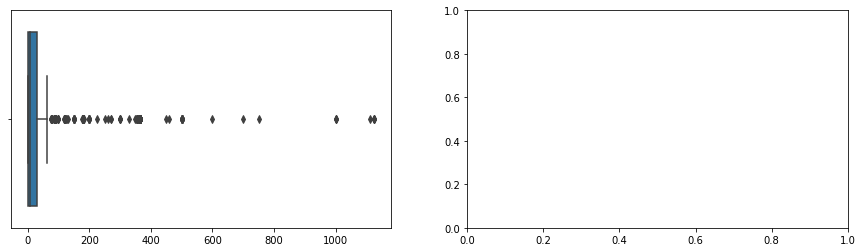

In [26]:
fig, ax = plt.subplots(1, 2, figsize = (15, 4))
sns.boxplot(x = list(data['minimum_nights']), ax = ax[0]); 

Using the multi-condition filter:



```
maximum_nights < 2200 & bedrooms < 10 & price < 4000
```



In [27]:
filtered_data = data.query("maximum_nights < 2200 & bedrooms < 8 & price < 2500 & num_of_bath< 8 & minimum_nights<360")

Compare the data with the filtered data using boxplot:

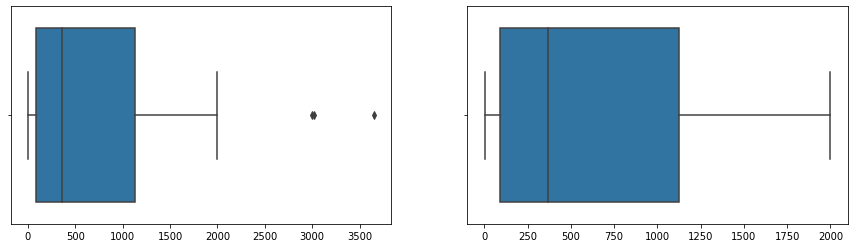

In [28]:
fig, ax = plt.subplots(1, 2, figsize = (15, 4))
sns.boxplot(x = list(data['maximum_nights']), ax = ax[0]); 
sns.boxplot(x = list(filtered_data['maximum_nights']), ax = ax[1]); 
plt.show()

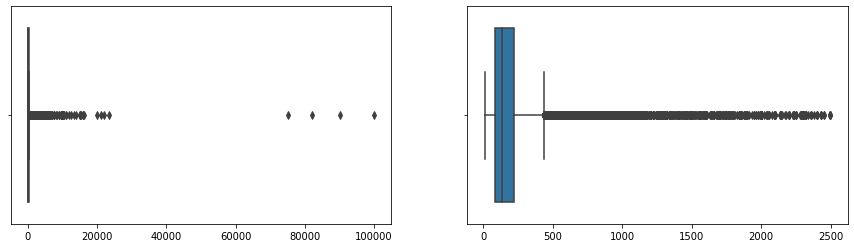

In [29]:
fig, ax = plt.subplots(1, 2, figsize = (15, 4))
sns.boxplot(x = list(data['price']), ax = ax[0]); 
sns.boxplot(x = list(filtered_data['price']), ax = ax[1]); 
plt.show() 

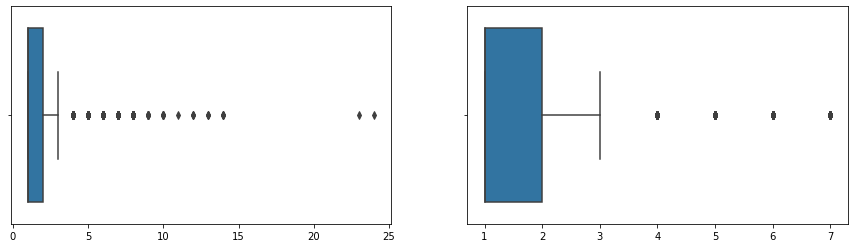

In [30]:
fig, ax = plt.subplots(1, 2, figsize = (15, 4))
sns.boxplot(x = list(data['bedrooms']), ax = ax[0]); 
sns.boxplot(x = list(filtered_data['bedrooms']), ax = ax[1]); 
plt.show()

The number of outliers is reduced, therefore the filtered data is better than the old one.

In [31]:
data = filtered_data

### **II.4. Randomize value** 

Randomize *availability_365* column:

In [32]:
v = data[data['availability_365'] != 0]
s = data[data['availability_365'] == 0]

filler = v['availability_365'].sample(n = len(s)).tolist()
s['availability_365'] = [a for a in filler]

randomized_data = pd.concat([s, v], ignore_index = True)

<ipython-input-32-3b426d04b523>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  s['availability_365'] = [a for a in filler]


Compared randomize data with data using boxplot:

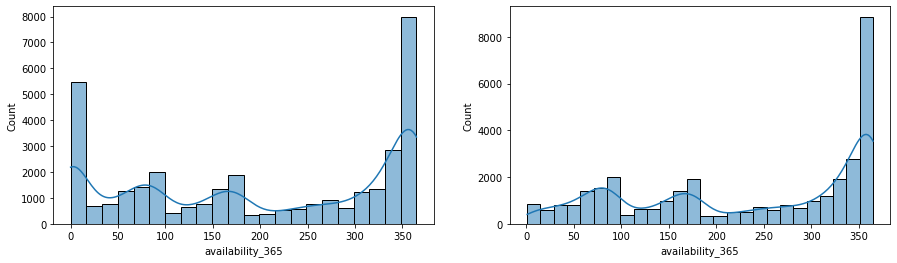

In [33]:
fig, ax = plt.subplots(1, 2, figsize = (15, 4))
sns.histplot(data['availability_365'], ax = ax[0], kde = True); 
sns.histplot(randomized_data['availability_365'], ax = ax[1], kde = True); 
plt.show()

After randomizing, the data has little change but all the zero values are removed

In [34]:
data = randomized_data

Randomize *number_of_reviews* column:

In [35]:
data.loc[data['number_of_reviews'] == 0, 'number_of_reviews'] = random.randint(1, 10)

### **II.5. Encoding binomial datadata**

Encode *host_identity_verified* column:

In [36]:
data['host_identity_verified'] = data['host_identity_verified'].replace({'t' : 1, 'f' : 0})

Encode *bath_type* column:

In [37]:
data['bath_type'] = data['bath_type'].replace({'private' : 1, 'share' : 0})

Encode *instant_bookable* column:

In [38]:
data['instant_bookable'] = data['instant_bookable'].replace({'t' : 1, 'f' : 0})

## **III. Data Processing**

### **General view** & **Map**

In [39]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34270 entries, 0 to 34269
Data columns (total 27 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           34270 non-null  int64  
 1   host_id                      34270 non-null  int64  
 2   host_identity_verified       34270 non-null  int64  
 3   neighbourhood_cleansed       34270 non-null  object 
 4   latitude                     34270 non-null  float64
 5   longitude                    34270 non-null  float64
 6   property_type                34270 non-null  object 
 7   room_type                    34270 non-null  object 
 8   accommodates                 34270 non-null  int64  
 9   bedrooms                     34270 non-null  float64
 10  amenities                    34270 non-null  object 
 11  price                        34270 non-null  float64
 12  minimum_nights               34270 non-null  int64  
 13  maximum_nights  

General description of columns (nominal columns excluded):

In [40]:
data.drop(columns = ['id', 'host_id', 'amenities']).describe().applymap(lambda x: f"{x:0.3f}").transpose()

,count,mean,std,min,25%,50%,75%,max
host_identity_verified,34270.000,0.879,0.326,0.000,1.000,1.000,1.000,1.000
latitude,34270.000,34.055,0.139,33.338,33.997,34.063,34.114,34.819
longitude,34270.000,-118.314,0.174,-118.916,-118.427,-118.345,-118.236,-117.653
accommodates,34270.000,3.845,2.616,1.000,2.000,3.000,5.000,16.000
bedrooms,34270.000,1.669,1.049,1.000,1.000,1.000,2.000,7.000
price,34270.000,208.845,253.329,10.000,85.000,135.000,225.000,2499.000
minimum_nights,34270.000,16.629,17.520,1.000,2.000,7.000,30.000,359.000
maximum_nights,34270.000,571.947,468.676,1.000,90.000,365.000,1125.000,2000.000
availability_365,34270.000,232.659,121.704,1.000,116.000,269.000,352.000,365.000
number_of_reviews,34270.000,40.629,76.781,1.000,4.000,9.000,41.000,1924.000


Heatmap:

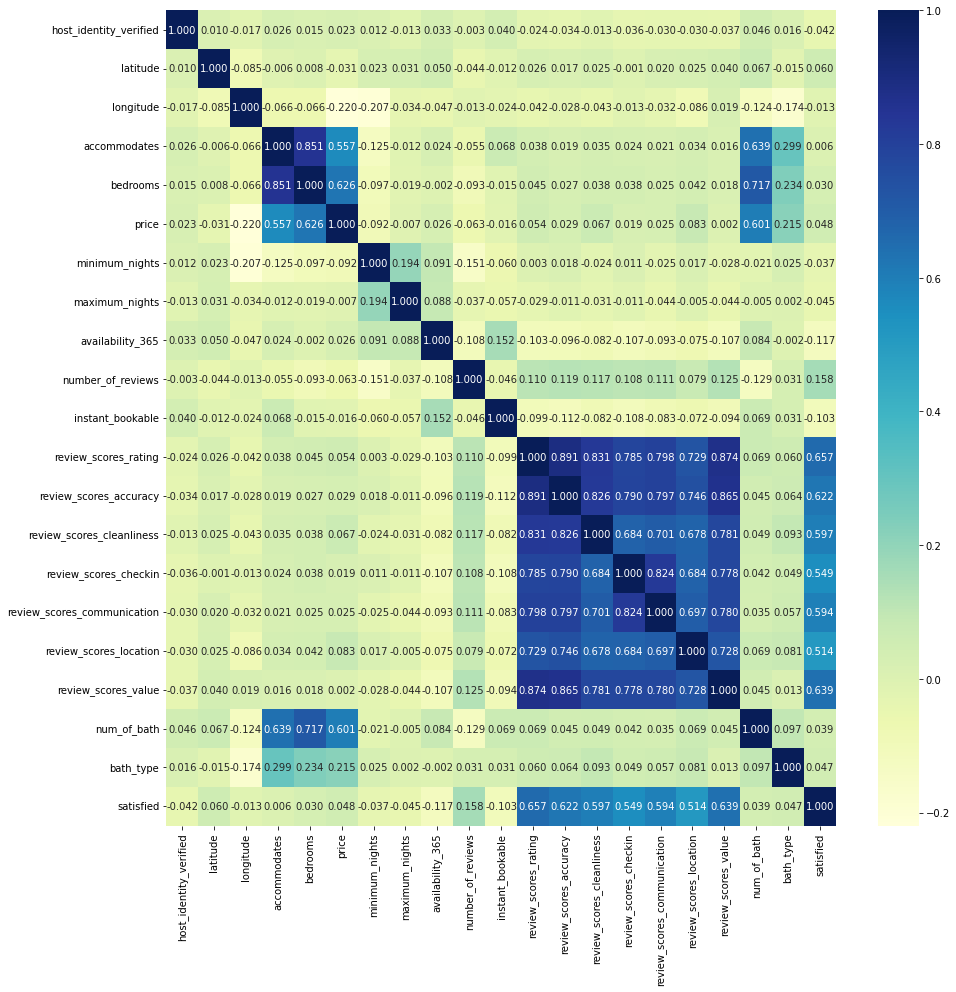

In [41]:
plt.figure(figsize = (15, 15))
dataplot = sns.heatmap(data.drop(columns = ['id', 'host_id', 'amenities']).corr(), fmt = '.3f', cmap = "YlGnBu", annot = True)
plt.show()

Using *Pandas Profiling* to report the data:

In [42]:
pandas_profiling.ProfileReport(data.drop(columns = ['id', 'host_id', 'amenities']))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Pairplot:

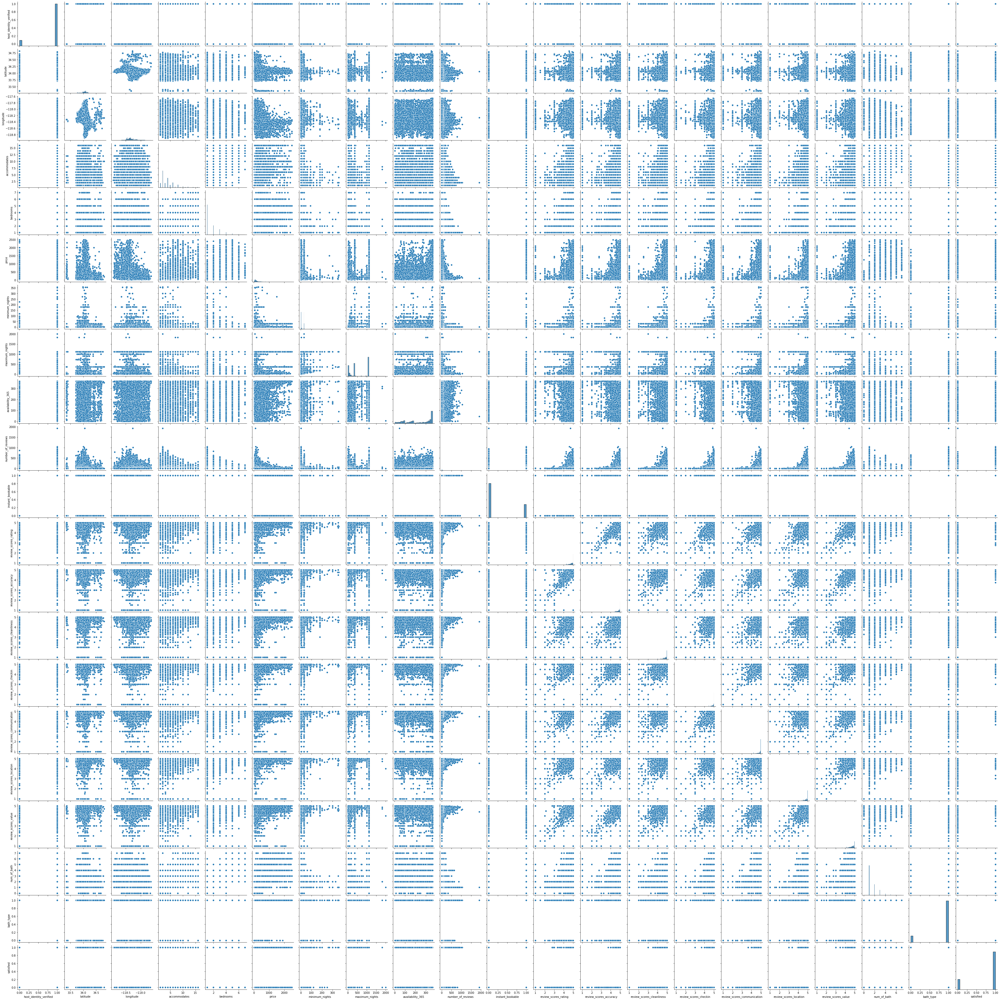

In [43]:
sns.pairplot(data.drop(columns = ['id', 'host_id', 'amenities']))

Position of *bungalow*, *cottage* and *condo* on the map:

In [44]:
icon_circle = BeautifyIcon(icon_shape = 'circle-dot', border_color = 'green', border_width = 3)
location = list(zip(data[data['property_type'].isin(['bungalow', 'cottage', 'condo'])].latitude, data[data['property_type'].isin(['bungalow', 'cottage', 'condo'])].longitude))
map_obj = fo.Map(location = [34, -118.2821872], zoom_start = 4)

for lo in location:
  fo.CircleMarker(lo, radius = lo[1] / 100, color = "#007849").add_to(map_obj)

map_obj

Position of *villa* on the map:

In [45]:
icon_circle = BeautifyIcon(icon_shape = 'circle-dot', border_color = 'green', border_width = 3)
location = list(zip(data[data['property_type'].isin(['villa'])].latitude, data[data['property_type'].isin(['villa'])].longitude))
map_obj = fo.Map(location = [34, -118.2821872], zoom_start = 4)

for lo in location:
  fo.CircleMarker(lo, radius = lo[1] / 100, color = "#007849").add_to(map_obj)

map_obj

Position of top 100 highest price accommodations on the map:

In [46]:
icon_circle = BeautifyIcon(icon_shape = 'circle-dot', border_color = 'green', border_width = 3)
location = list(zip(data.nlargest(100, 'price').latitude, data.nlargest(100, 'price').longitude))
map_obj = fo.Map(location = [34, -118.2821872], zoom_start = 4)

for lo in location:
  fo.CircleMarker(lo, radius = lo[1] / 100, color = "#007849").add_to(map_obj)

map_obj

In [47]:
d=data[data['property_type'].isin(['bungalow','cottage','condo'])]

<Figure size 3600x2880 with 0 Axes>

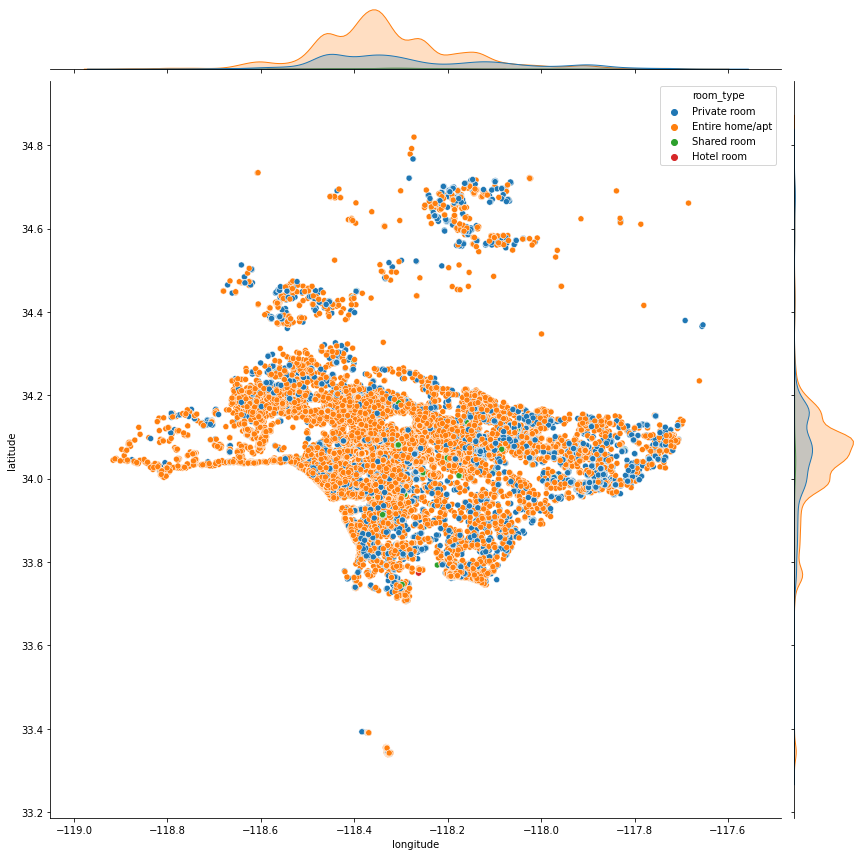

In [48]:
plt.figure(figsize = (50, 40))
sns.jointplot(data = data, y = "latitude", x = "longitude", hue = "room_type", height = 12, ratio = 10)

###Price

*property_type* and *accommodates* plot:

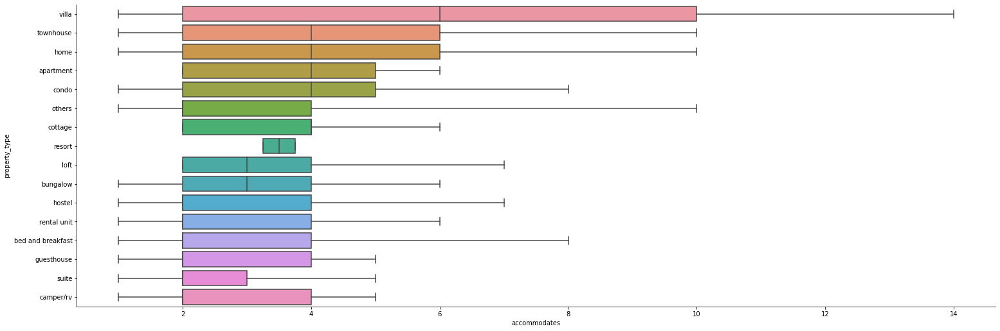

In [49]:
order = data.groupby('property_type')['accommodates'].mean().sort_values(ascending = False).index
sns.catplot(data = data, x = "accommodates", y = "property_type", kind = 'box', whis = [5, 95], height = 7.27, aspect = 21.7 / 7.27,
            showfliers = False, order = order)


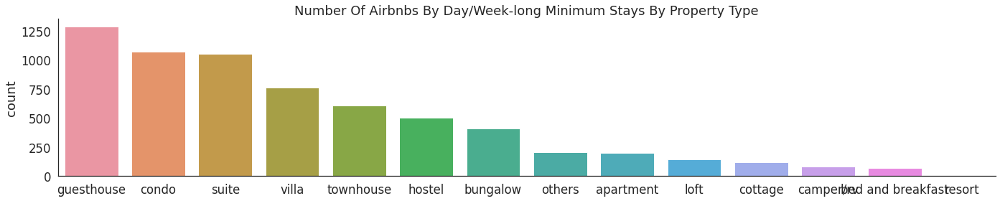

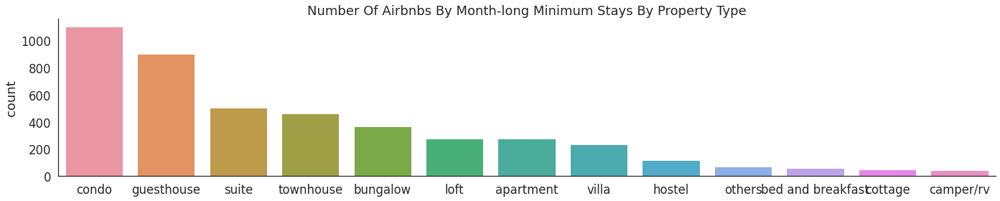

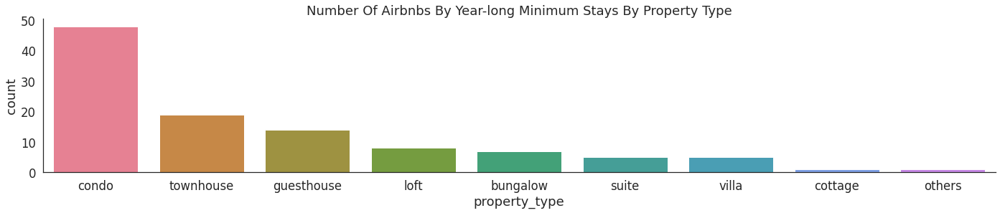

In [50]:
sns.set(font_scale = 1.5)
sns.set_style('white')

sort_order1 = data.query("property_type not in ('rental unit', 'home') and minimum_nights < 28").groupby('property_type')['minimum_nights']\
                        .count().sort_values(ascending = False).index
sns.catplot(data = data[data['minimum_nights'] < 28], x = 'property_type', kind = 'count', height = 4.27, aspect = 19.7 / 4.27, order = sort_order1 )\
            .set(title = 'Number Of Airbnbs By Day/Week-long Minimum Stays By Property Type').set(xlabel = None)

sort_order2 = data.query("property_type not in ('rental unit', 'home') and 28 <= minimum_nights <= 35").groupby('property_type')['minimum_nights']\
                        .count().sort_values(ascending = False).index
sns.catplot(data = data.query("property_type not in ('rental unit', 'home') and 28 <= minimum_nights <= 35"), x = 'property_type', kind = 'count', height = 4.27, aspect = 19.7 / 4.27, order = sort_order2)\
            .set(title = 'Number Of Airbnbs By Month-long Minimum Stays By Property Type').set(xlabel = None)

sort_order3 = data.query("property_type not in ('rental unit', 'home') and minimum_nights > 35").groupby('property_type')['minimum_nights']\
                        .count().sort_values(ascending = False).index
sns.catplot(data = data.query("property_type not in ('rental unit', 'home') and minimum_nights > 35"), x = 'property_type', kind = 'count', height = 4.27, aspect = 19.7 / 4.27, order = sort_order3, palette = sns.color_palette("husl", 10))\
            .set(title = 'Number Of Airbnbs By Year-long Minimum Stays By Property Type')

plt.subplots_adjust(hspace = 2)

*property_type* and *price* plot:

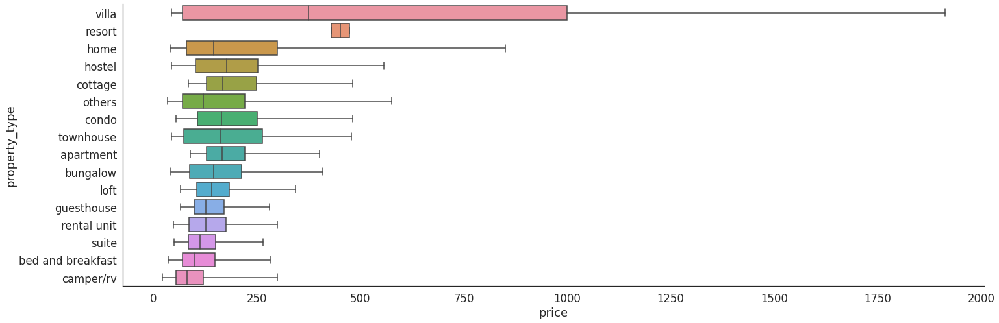

In [51]:
sort_order = data.groupby('property_type')['price'].mean().sort_values(ascending = False).index

sns.set_style('white')
sns.catplot(data = data, x = "price", y = "property_type", kind = 'box', whis = [5, 95], height = 7.27, aspect = 21.7 / 7.27, order = sort_order, showfliers = False)

In [52]:
data.groupby('property_type')['price'].mean().sort_values(ascending = False)

property_type
villa                607.974078
resort               451.500000
home                 251.732019
hostel               219.205032
cottage              212.075145
others               205.619565
condo                204.306982
townhouse            198.054079
apartment            194.339623
bungalow             174.185751
loft                 162.078704
guesthouse           146.232695
rental unit          146.068584
suite                131.772638
bed and breakfast    124.527559
camper/rv            107.256000
Name: price, dtype: float64

*property_type* and *room_type* heatmap:

<AxesSubplot:xlabel='room_type', ylabel='property_type'>

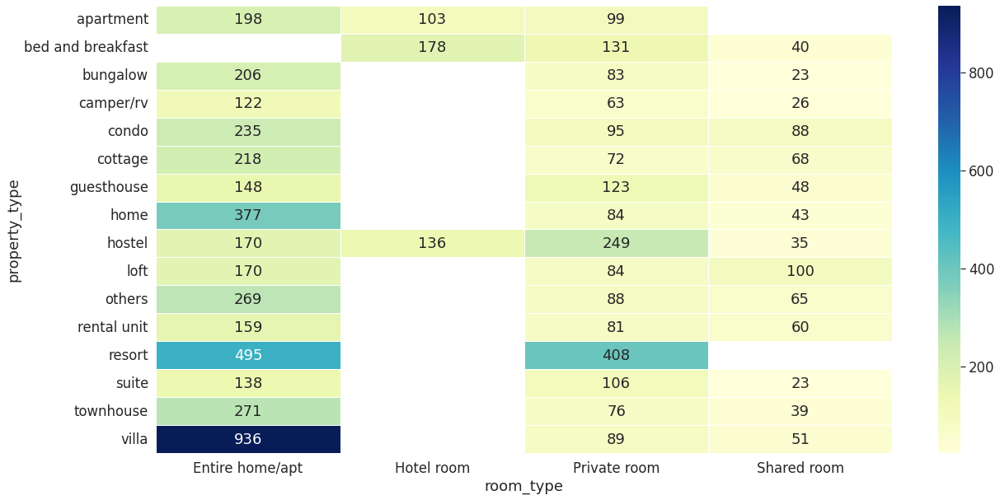

In [53]:
plt.figure(figsize = (20, 10))

df_crosstab = pd.crosstab(data["property_type"], data["room_type"], values = data["price"], aggfunc = "mean").round()
sns.heatmap(df_crosstab, fmt = '.4g', annot = True, cmap = "YlGnBu", linewidths = .5)

*longtitude* and *latitude* plot:

*price* and *bedrooms* correlation:

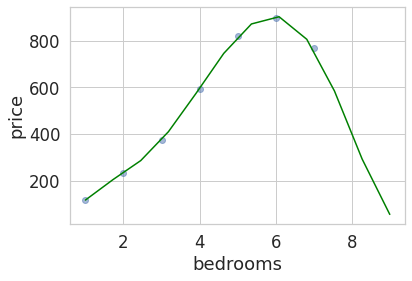

In [54]:
t = data
model1 = np.poly1d(np.polyfit(t['bedrooms'], t['price'], 5))
polyline = np.linspace(1, 9, 12)
grouped = t.groupby('bedrooms')
favor_by_age = grouped['price'].mean()

sns.set_style('whitegrid')
plt.plot(favor_by_age, 'o', alpha = 0.5)
plt.plot(polyline, model1(polyline), color = 'green')
plt.xlabel('bedrooms')
plt.ylabel('price')
plt.show()

In [55]:
print('Coefficient of Determination of model 1: ', r2_score(t['price'], model1(t['bedrooms'])))

Coefficient of Determination of model 1:  0.40178742768722586


*price* and *accommodates* correlation:

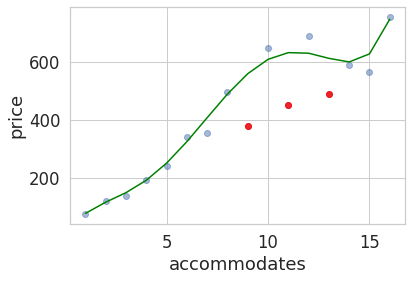

In [56]:
model2 = np.poly1d(np.polyfit(t['accommodates'], t['price'], 6))
polyline = np.linspace(1, 16, 16)
grouped = t.groupby('accommodates')
favor_by_age = grouped['price'].mean()

sns.set_style('whitegrid')
plt.plot(favor_by_age, 'o', alpha = 0.5)
plt.plot(polyline, model2(polyline), color = 'green')

extreme = pd.Series([favor_by_age.loc[9], favor_by_age.loc[11], favor_by_age.loc[13]], index = [9, 11, 13])

plt.plot(extreme, 'o', alpha = 0.8, color = 'red')
plt.xlabel('accommodates')
plt.ylabel('price')
plt.show()


In [57]:
print('Coefficient of Determination of model 2: ', r2_score(t['price'], model2(t['accommodates'])))

Coefficient of Determination of model 2:  0.3220673395219126


*price* and *num_of_bath* correlation:

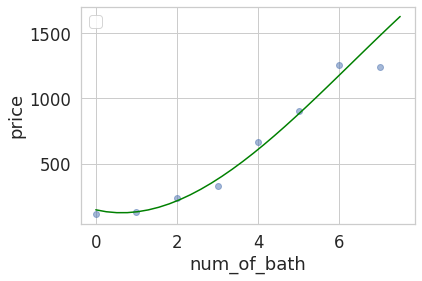

In [58]:

model3 = np.poly1d(np.polyfit(t['num_of_bath'], t['price'],3))
# model4 = np.poly1d(np.polyfit(t2['num_of_bath'], t2['price'], 9))
polyline = np.linspace(0, 7.5, 30)
grouped = t.groupby('num_of_bath')
favor_by_age = grouped['price'].mean()

sns.set_style('whitegrid')
plt.plot(favor_by_age, 'o', alpha = 0.5)
plt.plot(polyline, model3(polyline), color = 'green')
# plt.plot(polyline, model4(polyline), color = 'blue', label = 'Share')

# extreme = pd.Series([favor_by_age.loc[8], favor_by_age.loc[11]], index = [8, 11])

# plt.plot(extreme, 'o', alpha = 0.8, color = 'red')
plt.xlabel('num_of_bath')
plt.ylabel('price')
plt.legend()
plt.show()

In [59]:
print('Coefficient of Determination of model 3: ', r2_score(t['price'], model3(t['num_of_bath'])))

Coefficient of Determination of model 3:  0.3953786194953193


*price* and *nights* correlation:

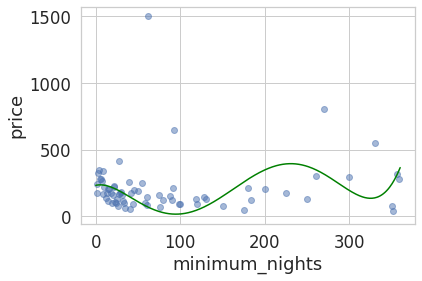

In [60]:
model5 = np.poly1d(np.polyfit(data['minimum_nights'], data['price'], 5))
polyline = np.linspace(0, 360, 380)
grouped = t.groupby('minimum_nights')
favor_by_age = grouped['price'].mean()

sns.set_style('whitegrid')
plt.plot(favor_by_age, 'o', alpha = 0.5)
plt.plot(polyline, model5(polyline), color = 'green')
plt.xlabel('minimum_nights')
plt.ylabel('price')
plt.show()

In [61]:
print('Coefficient of Determination of model 5: ', r2_score(t['price'], model5(t['minimum_nights'])))

Coefficient of Determination of model 5:  0.01368987714293668


### Satisfy

*instant_bookable* statistics:

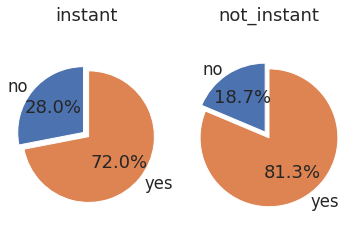

In [62]:
t = data.groupby(['instant_bookable', 'satisfied'])['satisfied'].count().unstack(level = 0)
labels = ['no', 'yes']
y = t[1].tolist()
n = t[0].tolist()

plt.subplot(1, 2, 1)
plt.pie(y, labels = labels, autopct = '%1.1f%%', explode = (0.1, 0), startangle = 90)
plt.axis('equal')
plt.title('instant')

plt.subplot(1, 2, 2)
plt.pie(n, labels = labels, autopct = '%1.1f%%', explode = (0.1, 0), startangle = 90)
plt.axis('equal')
plt.title('not_instant')
plt.show()



*room_type* statistics:

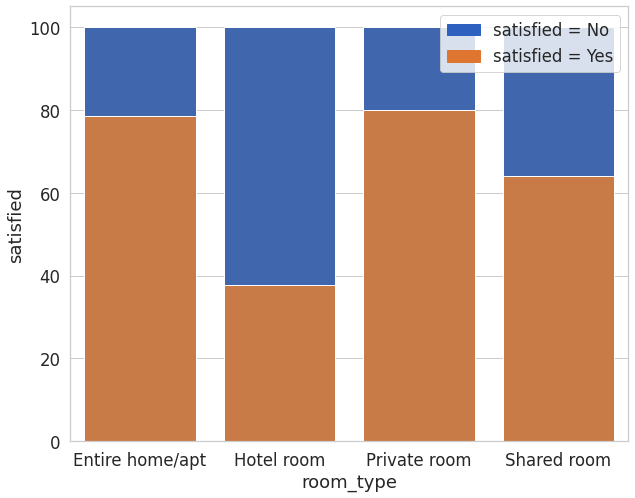

In [63]:

plt.figure(figsize = (10, 8))

total = data.groupby(['room_type'])['satisfied'].count().reset_index()
smoker = data[data.satisfied == 1].groupby('room_type')['satisfied'].count().reset_index()
smoker['satisfied'] = [i / j * 100 for i, j in zip(smoker['satisfied'], total['satisfied'])]
total['satisfied'] = [i / j * 100 for i, j in zip(total['satisfied'], total['satisfied'])]

bar1 = sns.barplot(x = "room_type", y = "satisfied", data = total, color = '#2e61bf')
bar2 = sns.barplot(x = "room_type", y = "satisfied", data = smoker, color = '#de7631')

top_bar = mpatches.Patch(color = '#2e61bf', label = 'satisfied = No')
bottom_bar = mpatches.Patch(color = '#de7631', label = 'satisfied = Yes')
plt.legend(handles = [top_bar, bottom_bar])

plt.show()

*satisfied* and *number_of_reviews* correlation:

<ipython-input-64-218ff103e376>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  t["sqrt_number_of_reviews"] = t["number_of_reviews"] ** 0.5


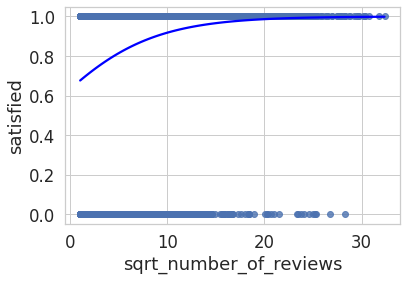

In [64]:
t = data[data["number_of_reviews"] < 1400]
t["sqrt_number_of_reviews"] = t["number_of_reviews"] ** 0.5

sns.regplot(x = "sqrt_number_of_reviews", y = "satisfied", data = t, ci = None, logistic = True, line_kws = {"color" : "blue"})
plt.show()

### price vs sastified

*price* and *host_identity_verified* plot:

<AxesSubplot:xlabel='host_identity_verified', ylabel='price'>

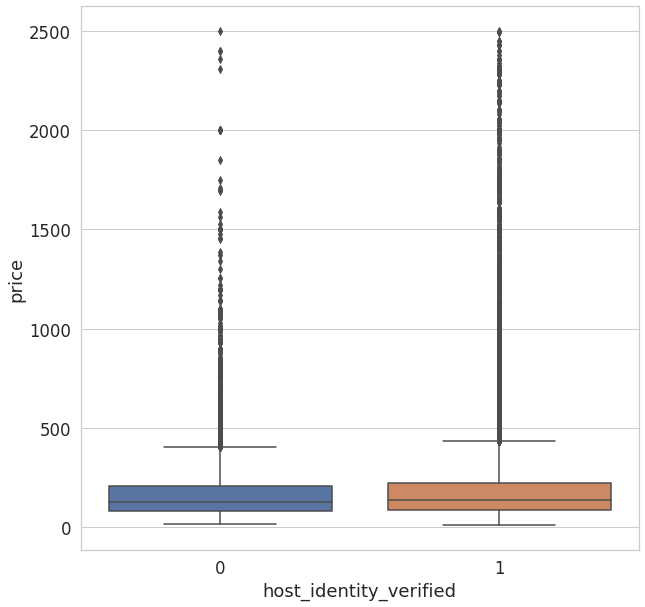

In [65]:
plt.figure(figsize = (10, 10))
sns.boxplot(y = 'price', x = 'host_identity_verified', data = data)

*satisfied* and *host_identity_verified* :

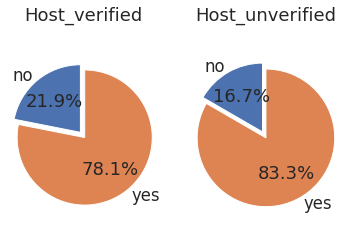

In [66]:
t = data.groupby(['host_identity_verified', 'satisfied'])['satisfied'].count().unstack(level = 0)
labels = ['no', 'yes']
y = t[1].tolist()
n = t[0].tolist()

plt.subplot(1, 2, 1)
plt.pie(y, labels = labels, autopct = '%1.1f%%', explode = (0.1, 0), shadow = False, startangle = 90)
plt.axis('equal')
plt.title('Host_verified')

plt.subplot(1, 2, 2)
plt.pie(n, labels = labels, autopct = '%1.1f%%', explode = (0.1, 0), shadow = False, startangle = 90)
plt.axis('equal')
plt.title('Host_unverified')

plt.show()

*price* and *satisfied* correlation:

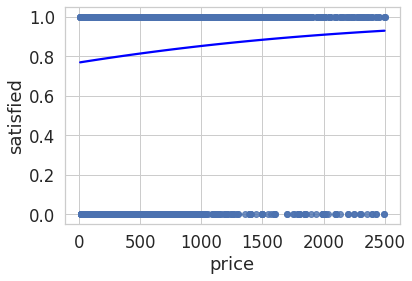

In [67]:
sns.regplot(x = "price", y = "satisfied", data = data, ci = None, logistic = True, line_kws = {"color" : "blue"})
plt.show()

In [68]:
a = data.query("minimum_nights < 35 and property_type not in ('resort','villa','camper/rv','bed and breakfast') and room_type=='Entire home/apt' and accommodates<=2")
a.loc[a['number_of_reviews'] < 20, 'number_of_reviews'] = 0
a.loc[a['number_of_reviews'] >= 20, 'number_of_reviews'] = 1

f = a['price'].mean()
a.loc[a['price'] < f, 'price'] = 0
a.loc[a['price'] >= f, 'price'] = 1

a['number_of_reviews'] = a['number_of_reviews'].replace([0, 1], ['reviews < 20', 'reviews >= 20'])
a['price'] = a['price'].replace([0, 1], ['price < average price', 'price >= average price'])

/usr/local/lib/python3.9/dist-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)
<ipython-input-68-70b5e2b7709b>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  a['number_of_reviews'] = a['number_of_reviews'].replace([0, 1], ['reviews < 20', 'reviews >= 20'])
<ipython-input-68-70b5e2b7709b>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = val

In [69]:
table = pd.pivot_table(a, index = ['number_of_reviews', 'price', 'satisfied'], aggfunc = 'count')
t = table['id'].unstack(level = -1)
t['satisfied_percentage'] = t[1] / (t[0] + t[1])

In [136]:
cm = sns.light_palette("green", as_cmap = True)

t.style.background_gradient(cmap = cm, subset = ["satisfied_percentage"]).set_precision(3)

<ipython-input-136-71904f2dcb79>:3: FutureWarning: this method is deprecated in favour of `Styler.format(precision=..)`
  t.style.background_gradient(cmap = cm, subset = ["satisfied_percentage"]).set_precision(3)


The quantity of reviews also impact the association between price and satisfied attributes. The outcome in satisfied_percentage imply that with fewer reviews and overpriced rental cost, the host may encounter unfavorable ratings from guests

##Modeling


Set up spark environment

In [71]:
!apt-get update
!apt-get install openjdk-8-jdk-headless -qq > /dev/null
!wget -q http://archive.apache.org/dist/spark/spark-3.1.1/spark-3.1.1-bin-hadoop3.2.tgz
!tar xf spark-3.1.1-bin-hadoop3.2.tgz
!pip install -q findspark
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "spark-3.1.1-bin-hadoop3.2"
import findspark
findspark.init()

Get:1 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Get:2 https://cloud.r-project.org/bin/linux/ubuntu focal-cran40/ InRelease [3,622 B]
Hit:3 http://archive.ubuntu.com/ubuntu focal InRelease
Get:4 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Hit:5 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal InRelease
Get:6 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Ign:7 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu2004/x86_64  InRelease
Get:8 http://security.ubuntu.com/ubuntu focal-security/universe amd64 Packages [1,015 kB]
Hit:9 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
Hit:10 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu2004/x86_64  Release
Hit:11 http://ppa.launchpad.net/cran/libgit2/ubuntu focal InRelease
Get:12 http://security.ubuntu.com/ubuntu focal-security/main amd64 Packages [2,539 kB]
Hit:13 http://ppa.lau

In [72]:
from pyspark import SparkConf, SparkContext

In [73]:
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
os.environ['PYSPARK_SUBMIT_ARGS'] = '--jars xgboost4j-spark.jar,xgboost4j.jar pyspark-shell'



In [74]:
spark = SparkSession\
        .builder\
        .appName("spark_tree_plotting")\
        .config("spark.executor.cores", 3) \
        .config("spark.executor.instances", 5) \
        .master("local[4]")\
        .getOrCreate()
# spark.sparkContext.addPyFile("spark-tree-plotting-dabddc53bf7b5de1e04c6fd40bf9f1c70cc13a98.zip")




In [75]:
from pyspark.ml.feature import StringIndexer, OneHotEncoder, VectorAssembler, VectorSlicer
from pyspark.ml import Pipeline
from pyspark.ml.tuning import CrossValidator
from pyspark.ml.tuning import ParamGridBuilder, TrainValidationSplit
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml.regression import LinearRegression



**Predicting price of accomodation that have high review score.**

###Preprocessing before modeling

In [76]:
filtered_data = data.query("review_scores_rating > 4 & review_scores_cleanliness > 4 & review_scores_accuracy > 4 & satisfied==1")
filtered_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26648 entries, 0 to 34269
Data columns (total 27 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           26648 non-null  int64  
 1   host_id                      26648 non-null  int64  
 2   host_identity_verified       26648 non-null  int64  
 3   neighbourhood_cleansed       26648 non-null  object 
 4   latitude                     26648 non-null  float64
 5   longitude                    26648 non-null  float64
 6   property_type                26648 non-null  object 
 7   room_type                    26648 non-null  object 
 8   accommodates                 26648 non-null  int64  
 9   bedrooms                     26648 non-null  float64
 10  amenities                    26648 non-null  object 
 11  price                        26648 non-null  float64
 12  minimum_nights               26648 non-null  int64  
 13  maximum_nights  

In [77]:
df=spark.createDataFrame(filtered_data.drop(columns=['id','host_id','amenities','review_scores_rating','review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value','satisfied','latitude','longitude']))
df.show(5)

+----------------------+----------------------+-------------+---------------+------------+--------+-----+--------------+--------------+----------------+-----------------+----------------+-----------+---------+
|host_identity_verified|neighbourhood_cleansed|property_type|      room_type|accommodates|bedrooms|price|minimum_nights|maximum_nights|availability_365|number_of_reviews|instant_bookable|num_of_bath|bath_type|
+----------------------+----------------------+-------------+---------------+------------+--------+-----+--------------+--------------+----------------+-----------------+----------------+-----------+---------+
|                     1|               Del Rey|         home|   Private room|           1|     1.0| 65.0|            30|          1125|             365|              226|               0|        1.0|        0|
|                     1|                Venice|  rental unit|Entire home/apt|           2|     1.0|205.0|            31|           330|             339|        

In [78]:
categorical_columns = ['neighbourhood_cleansed', 'property_type','room_type']
others= [ele for ele in df.columns if ele not in categorical_columns]
others.remove('price')

In [79]:
stringindexer_stages = [StringIndexer(inputCol=c, outputCol='strindexed_' + c) for c in categorical_columns]


In [80]:
onehotencoder_stages = [OneHotEncoder(inputCol='strindexed_' + c, outputCol='onehot_' + c) for c in categorical_columns]

In [81]:
feature_columns = ['onehot_' + c for c in categorical_columns]

feature_columns.extend(others)
feature_columns
vectorassembler_stage = VectorAssembler(inputCols=feature_columns, outputCol='features') 

In [82]:
feature_columns

['onehot_neighbourhood_cleansed',
 'onehot_property_type',
 'onehot_room_type',
 'host_identity_verified',
 'accommodates',
 'bedrooms',
 'minimum_nights',
 'maximum_nights',
 'availability_365',
 'number_of_reviews',
 'instant_bookable',
 'num_of_bath',
 'bath_type']

In [83]:
all_stages = stringindexer_stages + onehotencoder_stages + [vectorassembler_stage]
pipeline = Pipeline(stages=all_stages)

In [84]:
pipeline_model = pipeline.fit(df)

In [85]:
final_columns = ['features'] + ['price']
dfc = pipeline_model.transform(df).\
            select(final_columns)


In [86]:
dfc.show(5)

+--------------------+-----+
|            features|price|
+--------------------+-----+
|(291,[54,263,279,...| 65.0|
|(291,[1,264,278,2...|205.0|
|(291,[2,271,279,2...| 80.0|
|(291,[36,264,279,...| 62.0|
|(291,[36,264,279,...| 75.0|
+--------------------+-----+
only showing top 5 rows



In [87]:
training, test = dfc.randomSplit([0.8, 0.2], seed=1234)

###Random Forest Regressor

In [88]:
rf = RandomForestRegressor(featuresCol='features', labelCol='price', numTrees=26, maxDepth=13, maxBins=7, checkpointInterval=12)  

In [89]:
{param[0].name: param[1] for param in rf.extractParamMap().items()}

{'seed': -7008999573985494056,
 'maxDepth': 13,
 'maxBins': 7,
 'minInstancesPerNode': 1,
 'minInfoGain': 0.0,
 'maxMemoryInMB': 256,
 'cacheNodeIds': False,
 'checkpointInterval': 12,
 'impurity': 'variance',
 'subsamplingRate': 1.0,
 'numTrees': 26,
 'featureSubsetStrategy': 'auto',
 'leafCol': '',
 'minWeightFractionPerNode': 0.0,
 'bootstrap': True,
 'predictionCol': 'prediction',
 'featuresCol': 'features',
 'labelCol': 'price'}

In [90]:
  # paramGrid = ParamGridBuilder() \
  #   .addGrid(rf.checkpointInterval, [int(x) for x in np.linspace(start = 10, stop = 14, num = 3)]) \
  #   .addGrid(rf.maxDepth, [int(x) for x in np.linspace(start = 10, stop = 15, num = 3)]) \
  #   .addGrid(rf.maxBins, [int(x) for x in np.linspace(start = 5, stop = 8, num = 3)]) \
  #   .addGrid(rf.numTrees, [int(x) for x in np.linspace(start = 20, stop = 27, num = 3)]) \
  #   .build()
  

In [91]:
# tvs = TrainValidationSplit(estimator=rf,
#                            estimatorParamMaps=paramGrid,
#                            evaluator=rfevaluator,
#                            # 80% of the data will be used for training, 20% for validation.
#                            trainRatio=0.8,
#                            parallelism=8)

In [92]:
#rf after tunning
rf = RandomForestRegressor(featuresCol='features', labelCol='price', numTrees=26, maxDepth=13, maxBins=7, checkpointInterval=12)  

In [93]:
# model1 = tvs.fit(training)
model1=rf.fit(training)

In [94]:
pred1=model1.transform(test)
pred_train1=model1.transform(training)

In [95]:
rfevaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")

###Linear Regression

In [96]:
lr = LinearRegression(featuresCol='features', labelCol='price', maxIter=12, elasticNetParam=1)
paramGrid2 = ParamGridBuilder()\
    .addGrid(lr.regParam, [0.1, 0.3,0.035]) \
    .addGrid(lr.fitIntercept, [False, True])\
    .addGrid(lr.epsilon, [1.4, 1.6, 1.7])\
    .addGrid(lr.aggregationDepth, [2, 4])\
    .build()
# .addGrid(lr.elasticNetParam, [0.0, 0.5, 1.0])\

In [97]:
{param[0].name: param[1] for param in lr.extractParamMap().items()}

{'maxBlockSizeInMB': 0.0,
 'aggregationDepth': 2,
 'solver': 'auto',
 'standardization': True,
 'fitIntercept': True,
 'elasticNetParam': 1.0,
 'predictionCol': 'prediction',
 'featuresCol': 'features',
 'labelCol': 'price',
 'maxIter': 12,
 'regParam': 0.0,
 'tol': 1e-06,
 'loss': 'squaredError',
 'epsilon': 1.35}

In [98]:
tvs2 = TrainValidationSplit(estimator=lr,
                           estimatorParamMaps=paramGrid2,
                           evaluator=rfevaluator,
                           # 80% of the data will be used for training, 20% for validation.
                           trainRatio=0.8,
                           parallelism=5)

In [99]:
model2 = tvs2.fit(training)


In [100]:
pred2=model2.transform(test)
pred_train2=model2.transform(training)

###Assessing

Random Forest Regressor

In [101]:
RMSE_train1 = rfevaluator.evaluate(pred_train1)
RMSE1 = rfevaluator.evaluate(pred1)
print(RMSE_train1,RMSE1)

117.87984353698418 148.75731962281043


Linear Regression

In [102]:
RMSE_train2 = rfevaluator.evaluate(pred_train2)
RMSE2 = rfevaluator.evaluate(pred2)
print(RMSE_train2,RMSE2)

162.14901426830903 165.61972681977622


Feature importance

In [103]:
def ExtractFeatureImp(featureImp, dataset, featuresCol):
    list_extract = []
    for i in dataset.schema[featuresCol].metadata["ml_attr"]["attrs"]:
        list_extract = list_extract + dataset.schema[featuresCol].metadata["ml_attr"]["attrs"][i]
    varlist = pd.DataFrame(list_extract)
    varlist['score'] = varlist['idx'].apply(lambda x: featureImp[x])
    return(varlist.sort_values('score', ascending = False))

In [104]:
ExtractFeatureImp(model1.featureImportances, pred_train1, "features").head(10)


,idx,name,score
2,283,bedrooms,0.284401
8,289,num_of_bath,0.231200
1,282,accommodates,0.078536
279,269,onehot_property_type_villa,0.053941
34,24,onehot_neighbourhood_cleansed_Malibu,0.042663
288,278,onehot_room_type_Entire home/apt,0.027633
5,286,availability_365,0.027160
3,284,minimum_nights,0.025991
25,15,onehot_neighbourhood_cleansed_Hollywood Hills ...,0.023396
6,287,number_of_reviews,0.021867


##**Association rule with amenities**



In [105]:
amenities = data['amenities']

In [106]:
# define functions

def createArray(arr, gr):
  a = [0 for _ in range(len(gr.keys()))]
  l = list(gr.keys())

  for i in range(len(l)):
    a[i] = has(arr, gr[l[i]])
  
  return a

def has(arr, key):
  for k in key:
    k = k.lower()

    for i in arr:
      i = i.lower()
      if k in i:
        return 1
  return 0

In [107]:
# Split strings of amenities into arrays of strings of amenities

arr = []

for i in amenities:
  l = re.sub('[^a-zA-Z0-9, \n\.]', '', i[1:-1]).split(', ')
  arr.append(l)

In [108]:
len(arr)

34270

In [109]:
# Define columns of services

gr = {'tv' : ['tv', 'hdtv'],
      'wifi' : ['wifi', 'ethernet'],
      'sound_system' : ['sound system'],
      'pool' : ['pool'],
      'gym' : ['gym'],
      'boardgame' : ['game'],
      'ping_pong' : ['ping pong'],
      'book' : ['book'],
      'piano' : ['Piano'],
      'bike_renting' : ['Bikes', 'bike', 'bicycle'],
      'kayak_renting' : ['Kayak'],
      'EV_charger' : ['EV charger'],
      'luggage_carrier' : ['luggage'],
      'streaming_service' : ['Netflix', 'HBO Max', 'Roku', 'Amazon Prime Video', 'Chromecast'],
      'cable' : ['premium cable', 'standard cable'],
      'record/DVD_player' : ['Record player', 'DVD player'],
      'baby_facilities' : ['crib', 'baby'],
      'personal_workplace' : ['workplace'],
      'parking_lot' : ['parking'],
      'elevator' : ['elevator'],
      'smoke_alarm' : ['smoke alarm'],
      'CO_alarm' : ['carbon monoxide alarm'],
      'fire_extinguisher' : ['extinguisher'],
      'first_aid_kit' : ['first aid'],
      'security' : ['security', 'guard', 'staff'],
      'private_entrance' : ['private entrance'],
      'private_patio/balcony' : ['Private patio or balcony'],
      'private_garden/backyard' : ['Private fenced garden or backyard', 'Private garden or backyard'],
      'outdoor_dining' : ['outdoor dining area'],
      'breakfast' : ['breakfast'],
      'long_stays' : ['Long term stays'],
      'air_conditioning' : ['conditioning'],
      'fan' : ['fan', 'fans'],
      'mosquito_net' : ['Mosquito net'],
      'wardrobe' : ['wardrobe', 'dresser'],
      'changing_table' : ['Changing table'],
      'has_kitchen' : ['kitchen'],
      'oven/stove/microwave' : ['oven', 'stove', 'microwave', 'Baking sheet'],
      'refridgerator/freezer' : ['refridgerator', 'freezer'],
      'coffee machine' : ['coffee', 'Nespresso'],
      'kettle' : ['kettle', 'hot water'],
      'rice cooker' : ['rice'],
      'toaster' : ['bread', 'Toaster'],
      'dishwasher' : ['diswasher'],
      'kitchen_wares' : ['dishes', 'dinnerware'],
      'BBQ_utilities' : ['Barbecue utensils', 'Fire pit', 'BBQ grill'],
      'wine' : ['wine'],
      'hanger' : ['hangers'],
      'hair_dryer' : ['hair dryer'],
      'bidet' : ['Bidet'],
      'shampoo/soap' : ['shampoo', 'soap'],
      'conditioner/body_wash' : ['conditioner', 'body wash'],
      'bathtub' : ['bathtub', 'tub'],
      'sauna' : ['sauna'],
      'ironing' : ['iron'],
      'clothes_dryer' : ['dryer'],
      'washer' : ['washer'],
      'closet' : ['closet'],
      'heater/fireplace' : ['heating', 'fireplace'],
      'others' : ['pillow', 'chair'],}

df = pd.DataFrame(columns = gr.keys())

In [110]:
# Process the amenities from 0 to 9999

for i in range(0, 10000):
  df.loc[len(df)] = createArray(arr[i], gr)

In [111]:
# Process the amenities from 10000 to 19999

for i in range(10000, 20000):
  df.loc[len(df)] = createArray(arr[i], gr)

In [112]:
# Process the amenities from 20000 to 29999

for i in range(20000, 30000):
  df.loc[len(df)] = createArray(arr[i], gr)

In [113]:
# Process the amenities from 30000 to end

for i in range(30000, len(arr)):
  df.loc[len(df)] = createArray(arr[i], gr)

In [114]:
len(arr)

34270

In [115]:
# add id column

df['id'] = data['id']

In [116]:
# add satisfied column

df = df.join(data['satisfied']).astype({'satisfied' : int})

In [117]:
# Create table amenities:

arr = []
for i in df.columns:
  arr.append(i)

amenities = pd.DataFrame({'id' : [], 'satisfied' : [], 'has' : []})

for i in range(len(df)):
  a = ''
  for j in arr:
    if df[j].loc[i] == 1:
      a = a + j + '|'
  amenities.loc[len(amenities)] = [str(df['id'].loc[i]), df['satisfied'].loc[i], a[:-1]]

In [118]:
amenities = amenities.astype({'satisfied' : int})

Create a table based on *amenities* and *satisfied* column to show the services that satisfy customers:

In [119]:
%pip install mlxtend --upgrade
from mlxtend.preprocessing import TransactionEncoder 
from mlxtend.frequent_patterns import association_rules
from mlxtend.frequent_patterns import fpgrowth


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 61.5 MB/s eta 0:00:00
  Attempting uninstall: mlxtend
    Found existing installation: mlxtend 0.14.0
    Uninstalling mlxtend-0.14.0:
      Successfully uninstalled mlxtend-0.14.0


In [120]:
array = []
for i in df[df['satisfied'] == 1].drop(columns = ['id', 'satisfied']).sum().sort_values(ascending = False).to_dict().values():
    array.append(round(i / len(df), 3))

f = {'Service' : list(df[df['satisfied'] == 1].drop(columns=['id', 'satisfied']).sum().sort_values(ascending = False).to_dict().keys()),
     'Count' : list(df[df['satisfied'] == 1].drop(columns=['id', 'satisfied']).sum().sort_values(ascending = False).to_dict().values()),
     'Percent' : array}
mode = pd.DataFrame.from_dict(f)

In [121]:
mode[mode['Percent'] > 0.5]

,Service,Count,Percent
0,wifi,26720,0.780
1,smoke_alarm,25955,0.757
2,clothes_dryer,24795,0.724
3,parking_lot,24769,0.723
4,long_stays,24393,0.712
5,heater/fireplace,24305,0.709
6,has_kitchen,24301,0.709
7,tv,24006,0.700
8,CO_alarm,23679,0.691
9,hanger,22507,0.657


In [122]:
h=df[df['satisfied']==1]
h.drop(columns=['satisfied'], inplace= True)



/usr/local/lib/python3.9/dist-packages/pandas/core/frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [123]:
h.set_index('id',inplace=True)
d=h[h==1].stack().reset_index().drop(0,1)
c=d.values.tolist()

<ipython-input-123-2fd5fc24577b>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  d=h[h==1].stack().reset_index().drop(0,1)


In [124]:
# h=h.drop(columns=['id'])
# h

In [125]:
a=list(set(d['id'].tolist()))
len(a)
a

[25034755,
 52428810,
 35258379,
 25034768,
 747219174767329298,
 13762581,
 28180503,
 50987045,
 14549031,
 552336028815065133,
 48365618,
 39059513,
 47317050,
 650432920476450874,
 51904569,
 562300456194408513,
 620444389462507587,
 718494618331906127,
 735780593043505239,
 770251091097813081,
 39845981,
 733350524022161501,
 748017353066676320,
 48365669,
 131174,
 748085550193180777,
 653839011088564331,
 40894582,
 731498185671835790,
 40239251,
 30802068,
 27787414,
 31195287,
 12714144,
 584611549318873249,
 52691106,
 45220003,
 739150654853873830,
 29884585,
 3932334,
 6029497,
 44433596,
 25952458,
 716226650962788556,
 617541805709590732,
 53215440,
 45088983,
 613078808511906008,
 35389657,
 609022117821677786,
 46530780,
 53346526,
 8519906,
 51904742,
 558205075396755687,
 11534569,
 4325638,
 39059721,
 732916169283993867,
 52953358,
 262430,
 46661918,
 31981857,
 53215522,
 24379701,
 551505851666137403,
 50856254,
 31719747,
 53346637,
 46006606,
 48890194,
 622016

In [132]:
k=[]
for x in a:
  v=[]
  for y in c:
    if x==y[0]:
      v.append(y[1])
  k.append(v)

In [131]:
c

[[16985679, 'wifi'],
 [16985679, 'luggage_carrier'],
 [16985679, 'parking_lot'],
 [16985679, 'smoke_alarm'],
 [16985679, 'CO_alarm'],
 [16985679, 'fire_extinguisher'],
 [16985679, 'first_aid_kit'],
 [16985679, 'private_entrance'],
 [16985679, 'outdoor_dining'],
 [16985679, 'long_stays'],
 [16985679, 'has_kitchen'],
 [16985679, 'oven/stove/microwave'],
 [16985679, 'coffee machine'],
 [16985679, 'kettle'],
 [16985679, 'kitchen_wares'],
 [16985679, 'BBQ_utilities'],
 [16985679, 'hanger'],
 [16985679, 'hair_dryer'],
 [16985679, 'shampoo/soap'],
 [16985679, 'ironing'],
 [16985679, 'clothes_dryer'],
 [16985679, 'washer'],
 [16985679, 'heater/fireplace'],
 [16985679, 'others'],
 [49093882, 'tv'],
 [49093882, 'wifi'],
 [49093882, 'bike_renting'],
 [49093882, 'parking_lot'],
 [49093882, 'smoke_alarm'],
 [49093882, 'CO_alarm'],
 [49093882, 'fire_extinguisher'],
 [49093882, 'first_aid_kit'],
 [49093882, 'outdoor_dining'],
 [49093882, 'long_stays'],
 [49093882, 'air_conditioning'],
 [49093882, 'fa

In [133]:
k

[['tv',
  'wifi',
  'pool',
  'book',
  'luggage_carrier',
  'parking_lot',
  'smoke_alarm',
  'CO_alarm',
  'fire_extinguisher',
  'first_aid_kit',
  'security',
  'private_entrance',
  'private_patio/balcony',
  'outdoor_dining',
  'long_stays',
  'has_kitchen',
  'oven/stove/microwave',
  'coffee machine',
  'kettle',
  'kitchen_wares',
  'BBQ_utilities',
  'hanger',
  'hair_dryer',
  'shampoo/soap',
  'bathtub',
  'ironing',
  'clothes_dryer',
  'washer',
  'heater/fireplace'],
 ['tv',
  'wifi',
  'luggage_carrier',
  'parking_lot',
  'smoke_alarm',
  'CO_alarm',
  'first_aid_kit',
  'private_entrance',
  'outdoor_dining',
  'long_stays',
  'air_conditioning',
  'fan',
  'has_kitchen',
  'oven/stove/microwave',
  'coffee machine',
  'kettle',
  'toaster',
  'kitchen_wares',
  'BBQ_utilities',
  'hanger',
  'hair_dryer',
  'shampoo/soap',
  'conditioner/body_wash',
  'bathtub',
  'ironing',
  'clothes_dryer',
  'heater/fireplace',
  'others'],
 ['tv',
  'wifi',
  'book',
  'luggage_

In [134]:
frequent_itemsets_fp=fpgrowth(h, min_support=0.6, use_colnames=True)
frequent_itemsets_fp

/usr/local/lib/python3.9/dist-packages/mlxtend/frequent_patterns/fpcommon.py:111: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
0,0.990290,(wifi)
1,0.961938,(smoke_alarm)
2,0.918946,(clothes_dryer)
3,0.917982,(parking_lot)
4,0.904047,(long_stays)
...,...,...
7083,0.615151,"(wifi, shampoo/soap, air_conditioning)"
7084,0.602920,"(shampoo/soap, clothes_dryer, air_conditioning)"
7085,0.601772,"(smoke_alarm, shampoo/soap, air_conditioning)"
7086,0.601067,"(wifi, shampoo/soap, clothes_dryer, air_condit..."


In [135]:
rules_fp = association_rules(frequent_itemsets_fp, metric="confidence", min_threshold=0.8)
rules_fp

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(wifi),(smoke_alarm),0.990290,0.961938,0.955748,0.965120,1.003308,0.003151,1.091231
1,(smoke_alarm),(wifi),0.961938,0.990290,0.955748,0.993566,1.003308,0.003151,1.509148
2,(wifi),(clothes_dryer),0.990290,0.918946,0.913461,0.922418,1.003778,0.003438,1.044749
3,(clothes_dryer),(wifi),0.918946,0.990290,0.913461,0.994031,1.003778,0.003438,1.626783
4,(smoke_alarm),(clothes_dryer),0.961938,0.918946,0.890816,0.926064,1.007746,0.006847,1.096278
...,...,...,...,...,...,...,...,...,...
160706,"(wifi, clothes_dryer, air_conditioning)",(shampoo/soap),0.709881,0.795197,0.601067,0.846716,1.064788,0.036573,1.336104
160707,"(shampoo/soap, clothes_dryer, air_conditioning)",(wifi),0.602920,0.990290,0.601067,0.996926,1.006702,0.004001,3.159303
160708,"(shampoo/soap, air_conditioning)","(wifi, clothes_dryer)",0.617337,0.913461,0.601067,0.973645,1.065886,0.037154,3.283560
160709,"(clothes_dryer, air_conditioning)","(wifi, shampoo/soap)",0.713698,0.791787,0.601067,0.842187,1.063654,0.035970,1.319367
